In [29]:
#Importing necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.plotting import parallel_coordinates

In [2]:
#Reading csv file for fetching data
main_df = pd.read_csv('tcc_ceds_music.csv')

In [3]:
main_df.head()

,Unnamed: 0,artist_name,track_name,release_date,genre,lyrics,len,dating,violence,world/life,...,sadness,feelings,danceability,loudness,acousticness,instrumentalness,valence,energy,topic,age
0,0,mukesh,mohabbat bhi jhoothi,1950,pop,hold time feel break feel untrue convince spea...,95,0.000598,0.063746,0.000598,...,0.380299,0.117175,0.357739,0.454119,0.997992,0.901822,0.339448,0.137110,sadness,1.0
1,4,frankie laine,i believe,1950,pop,believe drop rain fall grow believe darkest ni...,51,0.035537,0.096777,0.443435,...,0.001284,0.001284,0.331745,0.647540,0.954819,0.000002,0.325021,0.263240,world/life,1.0
2,6,johnnie ray,cry,1950,pop,sweetheart send letter goodbye secret feel bet...,24,0.002770,0.002770,0.002770,...,0.002770,0.225422,0.456298,0.585288,0.840361,0.000000,0.351814,0.139112,music,1.0
3,10,pérez prado,patricia,1950,pop,kiss lips want stroll charm mambo chacha merin...,54,0.048249,0.001548,0.001548,...,0.225889,0.001548,0.686992,0.744404,0.083935,0.199393,0.775350,0.743736,romantic,1.0
4,12,giorgos papadopoulos,apopse eida oneiro,1950,pop,till darling till matter know till dream live ...,48,0.001350,0.001350,0.417772,...,0.068800,0.001350,0.291671,0.646489,0.975904,0.000246,0.597073,0.394375,romantic,1.0


In [5]:
#Now, let's print the attributes
main_df.columns

Index(['Unnamed: 0', 'artist_name', 'track_name', 'release_date', 'genre',
       'lyrics', 'len', 'dating', 'violence', 'world/life', 'night/time',
       'shake the audience', 'family/gospel', 'romantic', 'communication',
       'obscene', 'music', 'movement/places', 'light/visual perceptions',
       'family/spiritual', 'like/girls', 'sadness', 'feelings', 'danceability',
       'loudness', 'acousticness', 'instrumentalness', 'valence', 'energy',
       'topic', 'age'],
      dtype='object')

In [6]:
#Printing the info gives a better idea of datat type of all columns
#helps in deciding which features can be removed directly
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28372 entries, 0 to 28371
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                28372 non-null  int64  
 1   artist_name               28372 non-null  object 
 2   track_name                28372 non-null  object 
 3   release_date              28372 non-null  int64  
 4   genre                     28372 non-null  object 
 5   lyrics                    28372 non-null  object 
 6   len                       28372 non-null  int64  
 7   dating                    28372 non-null  float64
 8   violence                  28372 non-null  float64
 9   world/life                28372 non-null  float64
 10  night/time                28372 non-null  float64
 11  shake the audience        28372 non-null  float64
 12  family/gospel             28372 non-null  float64
 13  romantic                  28372 non-null  float64
 14  commun

In [8]:
main_df.shape

(28372, 31)

In [9]:
#Printing all the unique values 
unique_genres = main_df['genre'].unique()
print(unique_genres)

['pop' 'country' 'blues' 'jazz' 'reggae' 'rock' 'hip hop']


In [10]:
#Renaming Topic column to mood for better data handling
main_df.rename(columns={'topic':'mood'}, inplace = True)

In [11]:
#Printing attributes again to crosscheck whether renaming was successful or not
main_df.columns

Index(['Unnamed: 0', 'artist_name', 'track_name', 'release_date', 'genre',
       'lyrics', 'len', 'dating', 'violence', 'world/life', 'night/time',
       'shake the audience', 'family/gospel', 'romantic', 'communication',
       'obscene', 'music', 'movement/places', 'light/visual perceptions',
       'family/spiritual', 'like/girls', 'sadness', 'feelings', 'danceability',
       'loudness', 'acousticness', 'instrumentalness', 'valence', 'energy',
       'mood', 'age'],
      dtype='object')

In [12]:
#Checking unique values in mood 
unique_moods = main_df['mood'].unique()
print(unique_moods)

['sadness' 'world/life' 'music' 'romantic' 'violence' 'obscene'
 'night/time' 'feelings']


In [13]:
#So far we've got the desired columns by making few changes in the original dataset
#Now droppin all the irrelevant columns to get numeric columns in hand
#Printing head to check the action
desired_cols = ['sadness', 'world/life', 'music', 'romantic', 'violence', 'obscene',
 'night/time', 'feelings', 'danceability', 'loudness', 'acousticness', 'instrumentalness', 'valence', 'energy']
df = pd.read_csv('tcc_ceds_music.csv', usecols = desired_cols)
print(df.head())

   violence  world/life  night/time  romantic   obscene     music   sadness  \
0  0.063746    0.000598    0.000598  0.017104  0.000598  0.039288  0.380299   
1  0.096777    0.443435    0.001284  0.001284  0.001284  0.118034  0.001284   
2  0.002770    0.002770    0.002770  0.158564  0.002770  0.323794  0.002770   
3  0.001548    0.001548    0.001548  0.411536  0.001548  0.001548  0.225889   
4  0.001350    0.417772    0.001350  0.463430  0.001350  0.001350  0.068800   

   feelings  danceability  loudness  acousticness  instrumentalness   valence  \
0  0.117175      0.357739  0.454119      0.997992          0.901822  0.339448   
1  0.001284      0.331745  0.647540      0.954819          0.000002  0.325021   
2  0.225422      0.456298  0.585288      0.840361          0.000000  0.351814   
3  0.001548      0.686992  0.744404      0.083935          0.199393  0.775350   
4  0.001350      0.291671  0.646489      0.975904          0.000246  0.597073   

     energy  
0  0.137110  
1  0.26324

In [15]:
df.shape

(28372, 14)

In [16]:
#Shape of new dataframe tells a lot about the data
#Mean of energy is highest  
df.describe()

,violence,world/life,night/time,romantic,obscene,music,sadness,feelings,danceability,loudness,acousticness,instrumentalness,valence,energy
count,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,28372.000000,2.837200e+04,28372.000000,28372.000000,28372.000000
mean,0.118396,0.120973,0.057387,0.048681,0.097168,0.060047,0.129389,0.030996,0.533348,0.665249,3.392347e-01,0.080049,0.532864,0.569875
std,0.178684,0.172200,0.111923,0.106095,0.181303,0.123329,0.181143,0.071652,0.173218,0.108434,3.267143e-01,0.211245,0.250972,0.244385
min,0.000284,0.000291,0.000289,0.000284,0.000289,0.000289,0.000284,0.000289,0.005415,0.000000,2.811248e-07,0.000000,0.000000,0.000000
25%,0.001120,0.001170,0.001032,0.000975,0.001053,0.000975,0.001144,0.000993,0.412975,0.595364,3.423598e-02,0.000000,0.329143,0.380361
50%,0.002506,0.006579,0.001949,0.001754,0.001815,0.001815,0.005263,0.001754,0.538612,0.679050,2.259028e-01,0.000085,0.539365,0.580567
75%,0.192608,0.197793,0.065842,0.042301,0.088765,0.055101,0.235113,0.032622,0.656666,0.749026,6.325298e-01,0.009335,0.738252,0.772766
max,0.981781,0.962105,0.973684,0.940789,0.992298,0.956938,0.981424,0.958810,0.993502,1.000000,1.000000e+00,0.996964,1.000000,1.000000


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28372 entries, 0 to 28371
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   violence          28372 non-null  float64
 1   world/life        28372 non-null  float64
 2   night/time        28372 non-null  float64
 3   romantic          28372 non-null  float64
 4   obscene           28372 non-null  float64
 5   music             28372 non-null  float64
 6   sadness           28372 non-null  float64
 7   feelings          28372 non-null  float64
 8   danceability      28372 non-null  float64
 9   loudness          28372 non-null  float64
 10  acousticness      28372 non-null  float64
 11  instrumentalness  28372 non-null  float64
 12  valence           28372 non-null  float64
 13  energy            28372 non-null  float64
dtypes: float64(14)
memory usage: 3.0 MB


# BOXPLOTS

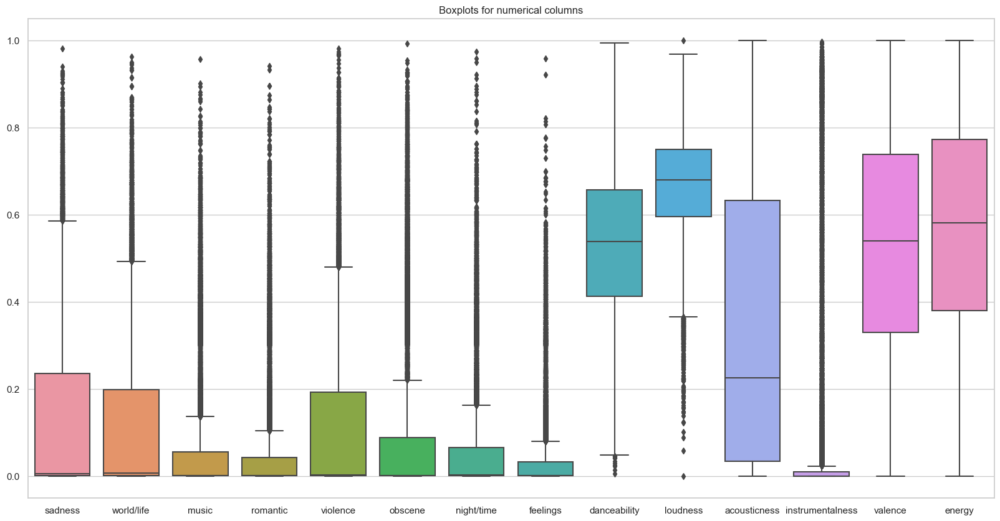

In [20]:
#Checking mathematical relations between all the numeric values through boxplots
sns.set(style = 'whitegrid')

plt.figure(figsize=(20,10))
sns.boxplot(data = df[desired_cols])
plt.title('Boxplots for numerical columns')
plt.show()

In [ ]:
#So the instrumentalness lags pretty much with very heavy outliers, which doesn't serves our purpose

# CORRELATION MATRIX AND HEATMAP

In [21]:
# Getting a correlation matrix, which eventually helps to know how two variables are linearly related with each other.
correlation_matrix = df.corr()
print(correlation_matrix)

                  violence  world/life  night/time  romantic   obscene  \
violence          1.000000   -0.186789   -0.124258 -0.155388 -0.159710   
world/life       -0.186789    1.000000   -0.116167 -0.071947 -0.211402   
night/time       -0.124258   -0.116167    1.000000 -0.039608 -0.116800   
romantic         -0.155388   -0.071947   -0.039608  1.000000 -0.158589   
obscene          -0.159710   -0.211402   -0.116800 -0.158589  1.000000   
music            -0.159064   -0.128573   -0.070488 -0.041048 -0.133812   
sadness          -0.221109   -0.159507   -0.103862 -0.044626 -0.266085   
feelings         -0.081423   -0.053378   -0.000237 -0.022149 -0.075439   
danceability     -0.097158   -0.071322    0.005706 -0.077717  0.273376   
loudness          0.128613   -0.049222   -0.000162 -0.145113  0.138025   
acousticness     -0.189563    0.037925   -0.011262  0.222060 -0.158011   
instrumentalness  0.105619   -0.016699   -0.000076 -0.026033 -0.002937   
valence          -0.070012   -0.086404

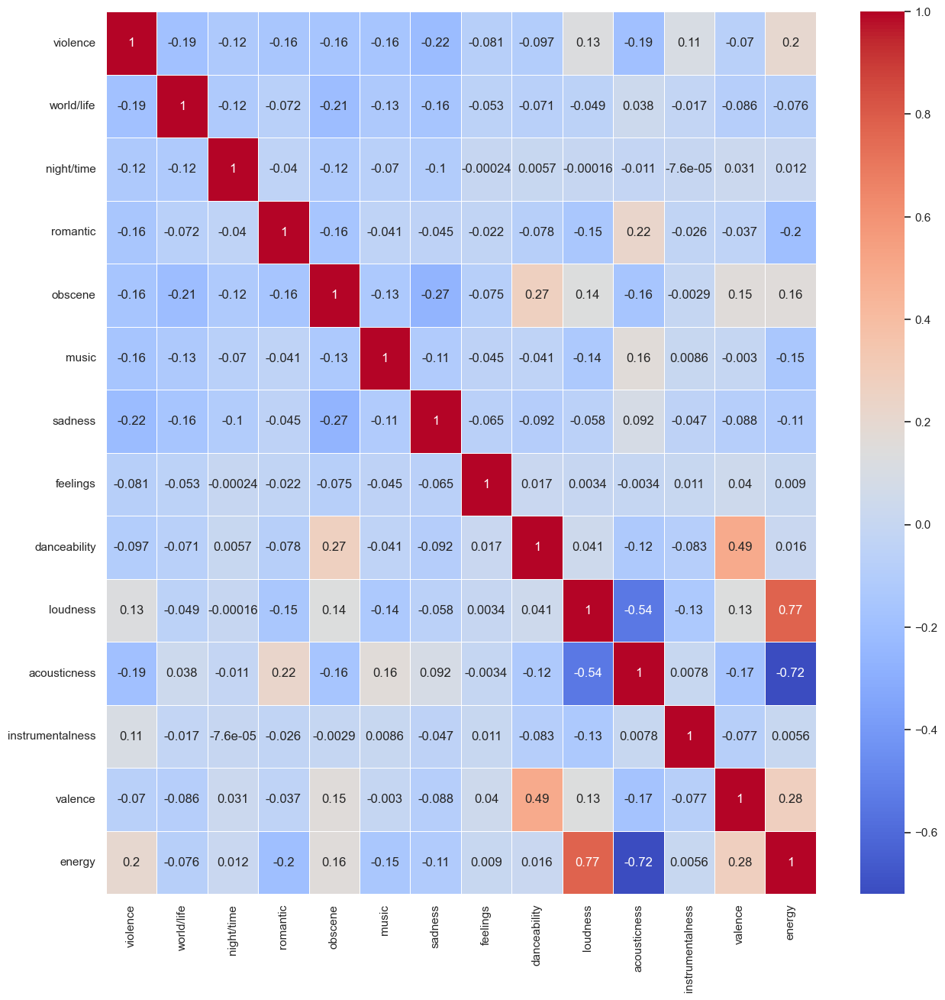

In [27]:
# Representing the above correlation with the help of a Heatmap
fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(correlation_matrix, annot = True, cmap = 'coolwarm', linewidths = 0.5)
plt.show()

In [ ]:
#Here we can see the pairs which are pretty much correlated are:

#Loudness and Energy - Strong
#Acousticness and Energy - Strong
#Loudness and Acousticness - Moderate
#Danceability and Valence - Moderate
#Sadness and Obscene - Weak
#Valence and Energy - Weak
#Sadness and Violence - Weak

# PAIRPLOTS

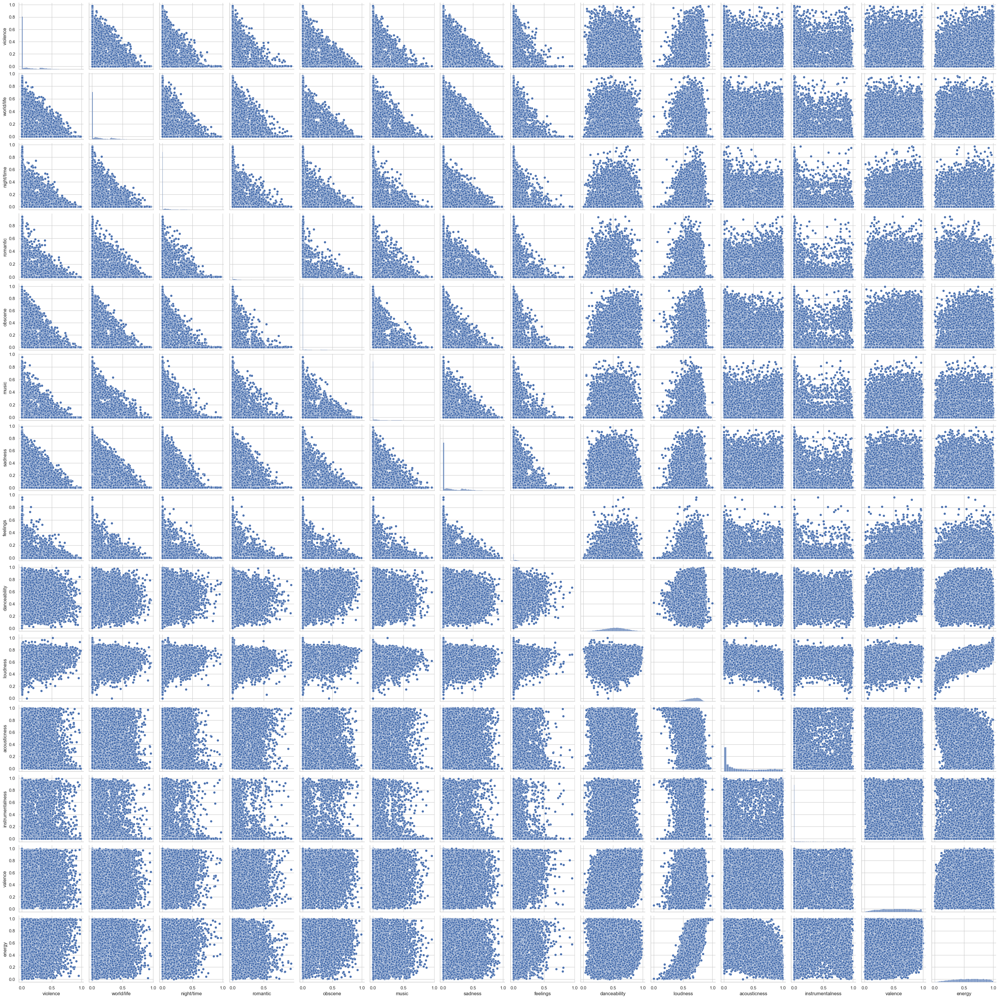

In [28]:
sns.pairplot(df)

In [ ]:
# After checking the scatter plots we could see Energy and Loudness are having Sigmoid Function Similarity
# Most other plots are almost linear with a negative slope

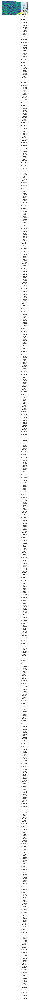

In [35]:
# Normalize numerical columns
df_normalized = df.copy()
df_normalized[df_normalized.columns] = df_normalized[df_normalized.columns].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

# Plot parallel coordinates
plt.figure(figsize=(10, 6))
parallel_coordinates(df_normalized[['danceability', 'valence', 'energy', 'loudness']],'energy', colormap='viridis')
plt.show()


In [38]:
import plotly.express as px
# Normalize numerical columns
df_normalized = df.copy()
df_normalized[df_normalized.columns] = df_normalized[df_normalized.columns].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

# Plot interactive parallel coordinates
fig = px.parallel_coordinates(df_normalized[['danceability', 'valence', 'energy', 'loudness']], color='energy')
fig.show()



# Finding relation between genres and moods: